# Day 1: Image Basics


In [ ]:
!pip install 

In [4]:
# importing needed libraries globally
from PIL import Image # for reading images
import numpy as np # for arrays manipulations
import matplotlib.pyplot as plt # for 2D plottings

## Digital Image

In [5]:
# helper functions
def red(im):
    """
    Receive multi channels of an image and return the red channel
    """
    return im[:,:,0]
def green(im):
    """
    Receive multi channels of an image and return the green channel
    """
    return im[:,:,1]
def blue(im):
    """
    Receive multi channels of an image and return the blue channel
    """
    return im[:,:,2]

Notes:

1. Images stored in computers as 2D float or integer arrays. 
2. Each value represents a pixel on the screen. 
3. If the size of the image is 100X100, than that means the image has a 2D array of size 100X100. 
4. Each entry in the array can have 1 or multiple values. <br/>
    a. If an image is gray, then an entry would have 1 value.  <br/>
    b. If the image is colored, than the image would have 3 values per entry. <br/>
    c. if transparecy is considered, than the image would have 4 values.  <br/>
    d. some images but less common have 5 values per entry <br/>

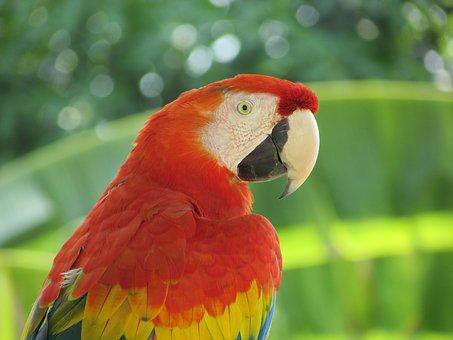

In [3]:
# Reading image using Image from pillow module
parrot = Image.open("imgs/parrot.png")
parrot

In [4]:
# Checking the size of the image
parrot.size

(453, 340)

In [5]:
# checking types and number of channels
parrot_arr = np.asarray(parrot)
parrot.getbands(), parrot_arr.dtype

(('R', 'G', 'B'), dtype('uint8'))

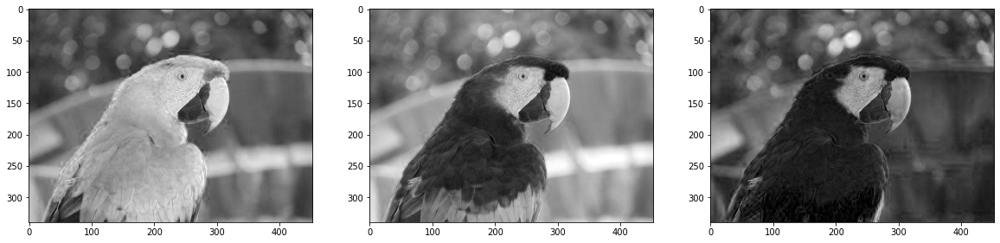

In [6]:
# showing intensity for each channel
fig, ax = plt.subplots(ncols=3)
ax[0].imshow(red(parrot_arr),cmap="gray")
ax[1].imshow(green(parrot_arr),cmap="gray")
ax[2].imshow(blue(parrot_arr),cmap="gray")
fig.set_size_inches((20,10))

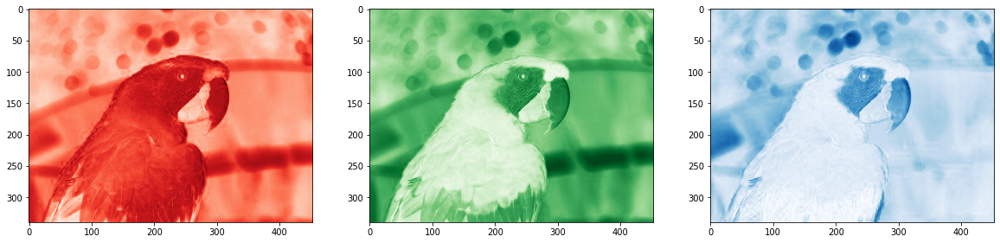

In [7]:
# Using better cmap
fig, ax = plt.subplots(ncols=3)
ax[0].imshow(red(parrot_arr),cmap=plt.cm.Reds)
ax[1].imshow(green(parrot_arr),cmap=plt.cm.Greens)
ax[2].imshow(blue(parrot_arr),cmap=plt.cm.Blues)
fig.set_size_inches((20,10))

## Applying basic mathematical operations

Because images are stored as numbers, we can apply any mathematical operation on them globally or locally. Here we show the basic Exponents, Multiplication. Division,  Addition and Subtraction operations. However, **one needs to make sure that the resulted values don't overflow the allowed range ([0-255] for uint8 and [0-1] for float**

In [1]:
def plot_grid(imarrays,titles):
    """
    show four images
    """
    count = 1
    plt.figure(figsize=(20,20))
    for im,t in zip(imarrays,titles):
        plt.subplot(220+count)
        ax = plt.gca()
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator()) 
        count += 1
        if len(im.shape) < 3:
            plt.imshow(im,cmap="gray")
        else:
            plt.imshow(im)
        plt.title(t, size=20)   
    plt.show()

In [9]:
# Openning parrot image 
# copy to allow modification
parrot = np.asarray(Image.open("imgs/parrot.png")).copy()

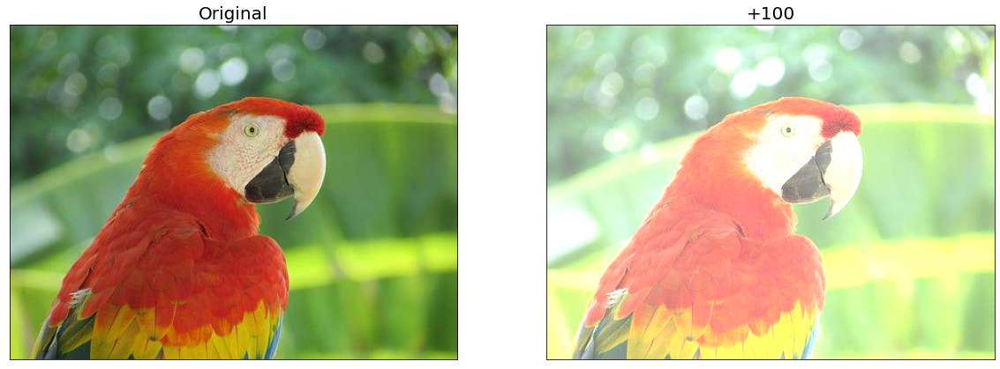

In [10]:
# adding n to the image
n = 100
parrotN = parrot.astype(np.int)
parrotN += n
parrotN = np.clip(parrotN,0,255)
plot_grid([parrot,parrotN],["Original", f"+{n}"])

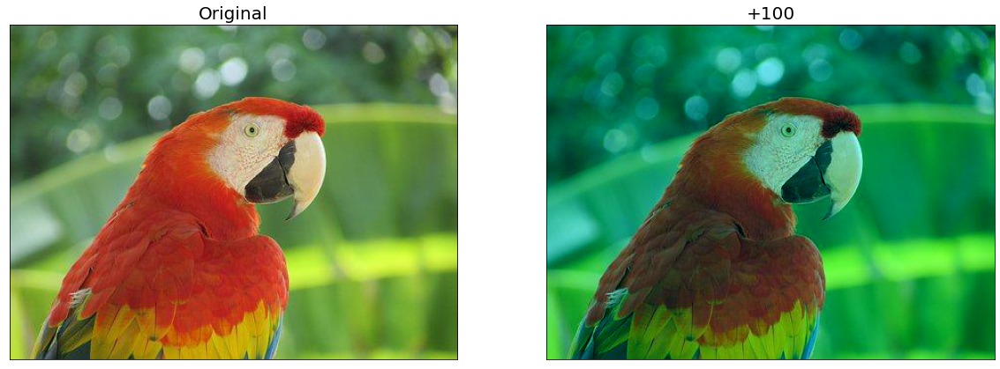

In [11]:
# adding n to the image
n = 100
parrotN = parrot.astype(np.int)
parrotN[:,:,0] -= n
parrotN = np.clip(parrotN,0,255)
plot_grid([parrot,parrotN],["Original", f"+{n}"])

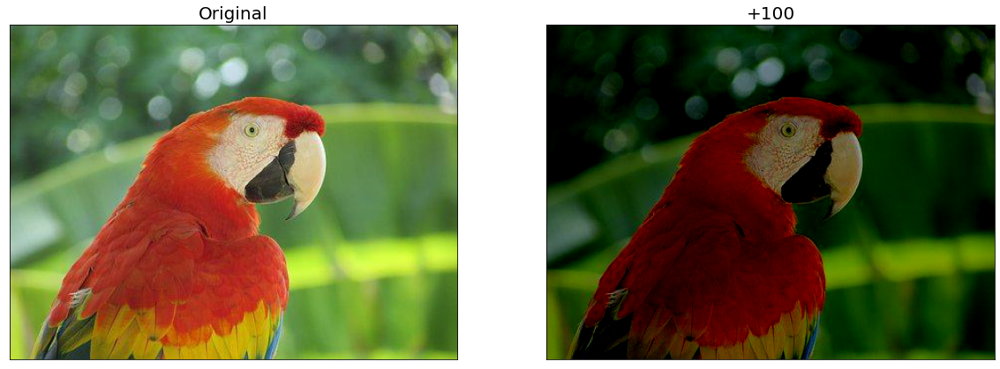

In [12]:
# subtracting n to the image
n = 100
parrotN = parrot.astype(np.int)
parrotN -= n
parrotN = np.clip(parrotN,0,255)
plot_grid([parrot,parrotN],["Original", f"+{n}"])

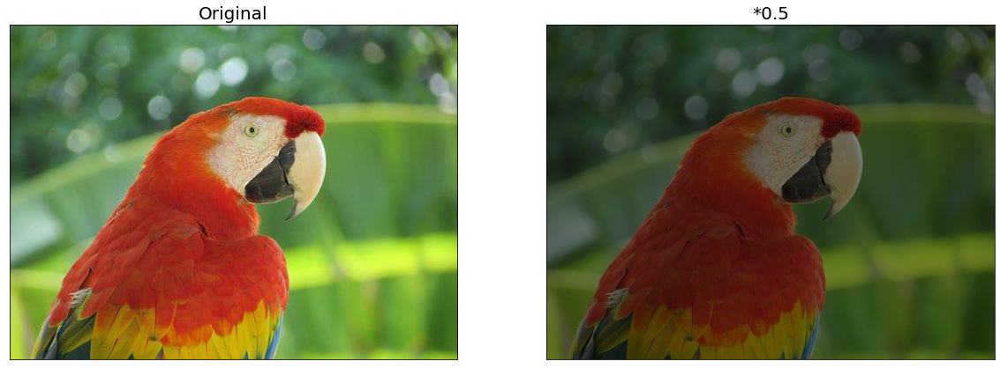

In [13]:
# multiplying the image with n
n = 0.5
parrotN = np.clip((parrot.astype(np.float)*n).astype(np.uint8),0,255)
plot_grid([parrot,parrotN],["Original", f"*{n}"])

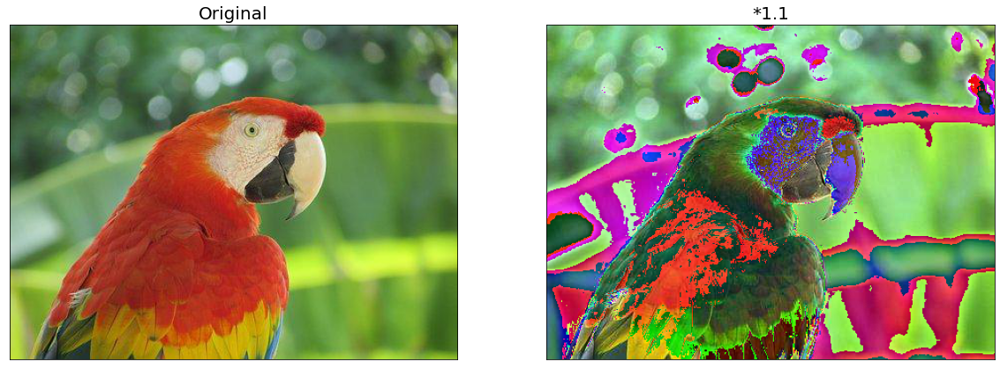

In [14]:
# exponential
n = 1.1
parrotToN = np.clip((parrot.astype(np.float)**n).astype(np.uint8),0,255)
plot_grid([parrot,parrotToN],["Original", f"*{n}"])

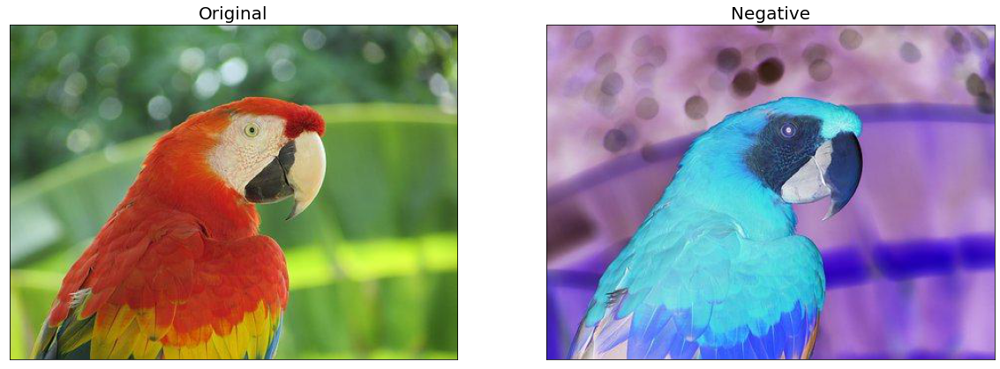

In [15]:
# negating an image
nParrot = np.clip(255-parrot,0,255)
plot_grid([parrot,nParrot],["Original", f"Negative"])

To see what is happening in the previous image, look at the rgb color space below. We will talk about color space downward

<img src="imgs/RGB_color_solid_cube.png" />

## Applying thresholding

Thresholding is very interesting technique to produce sharpening and darkining effects on an image. You can apply thresholding to set the minimum and maximum intensity of an image or of a certain channel.

In [16]:
# Openning parrot image 
# copy to allow modification
parrot = np.asarray(Image.open("imgs/parrot.png")).copy()

In [ ]:
parrot_t[parrot_t<t] = 0


parrot_t < 0     -> 0
parrot_t > 0     -> parrot_t

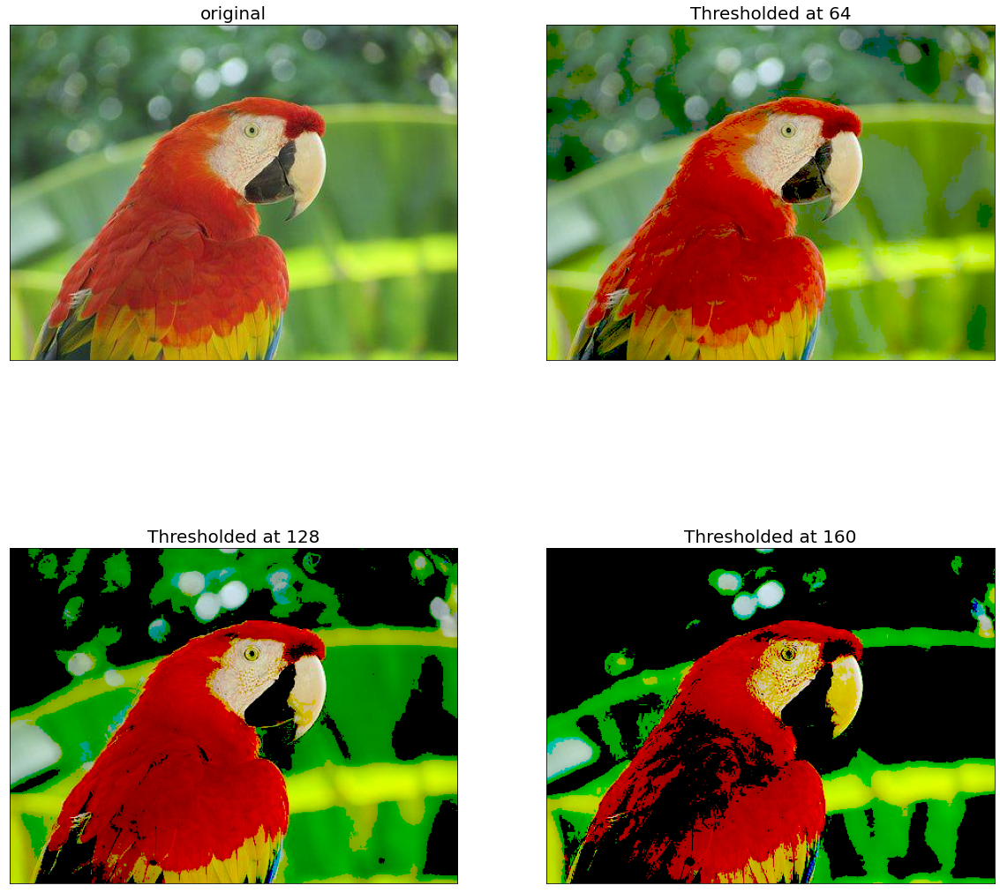

In [17]:
# Darkening image by zeroing any value above t for all cahnnels
max_i = [64,128,160]
imgs = []
for t in max_i:
    parrot_t = parrot.copy()
    parrot_t[parrot_t<t] = 0
    imgs.append(parrot_t)
plot_grid([parrot]+imgs,["original"]+[f"Thresholded at {t}" for t in max_i])

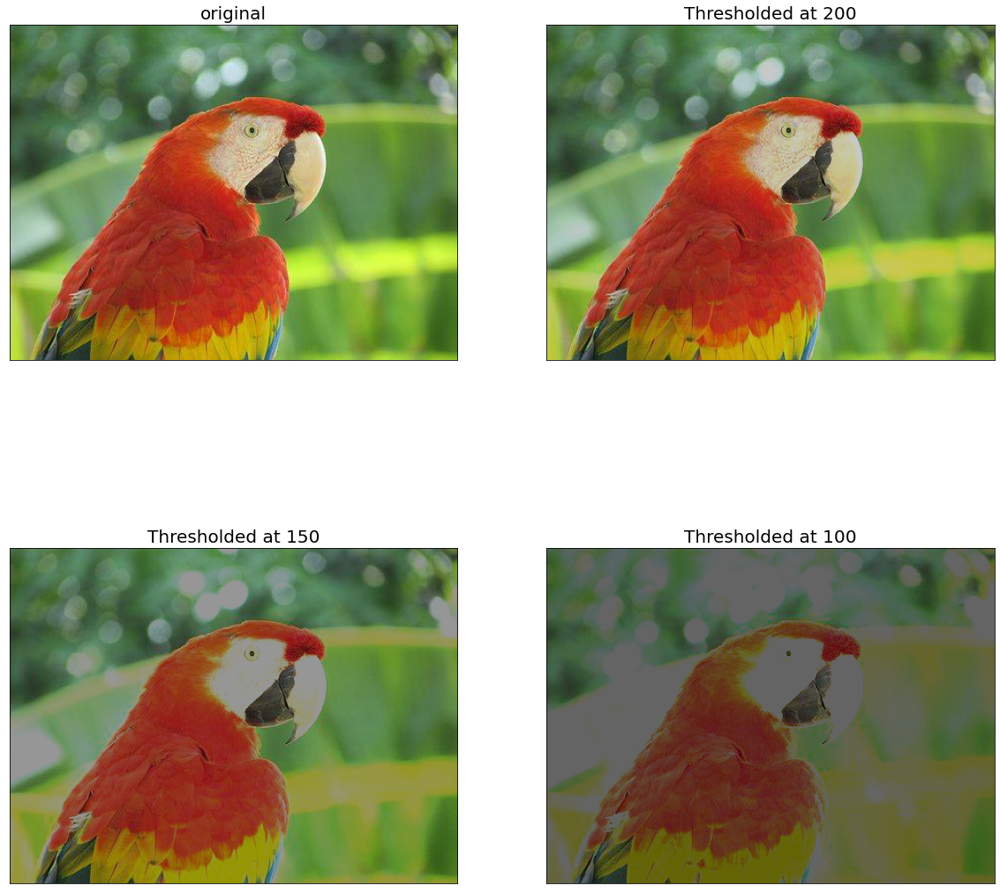

In [20]:
# Brightning image by zeroing any value above t for all cahnnels
max_i = [200,150,100]
imgs = []
for t in max_i:
    parrot_t = parrot.copy()
    parrot_t[parrot_t>t] = t
    imgs.append(parrot_t)
plot_grid([parrot]+imgs,["original"]+[f"Thresholded at {t}" for t in max_i])

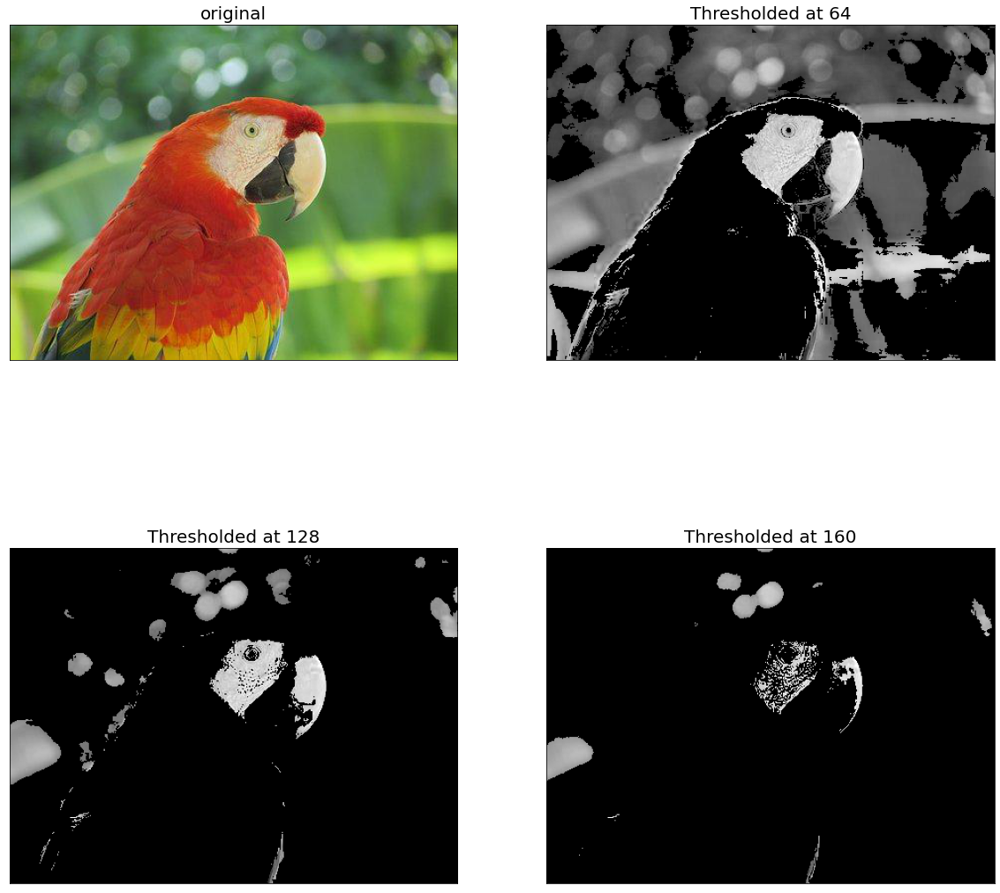

In [30]:
# Darkening on one channel
max_i = [64,128,160]
imgs = []
for t in max_i:
    parrot_t = parrot.copy()
    parrot_t[parrot_t[:,:,2]<t] = 0
    imgs.append(parrot_t)
plot_grid([parrot]+imgs,["original"]+[f"Thresholded at {t}" for t in max_i])

### Thresholding on binary image

$$f(x,y) = v$$

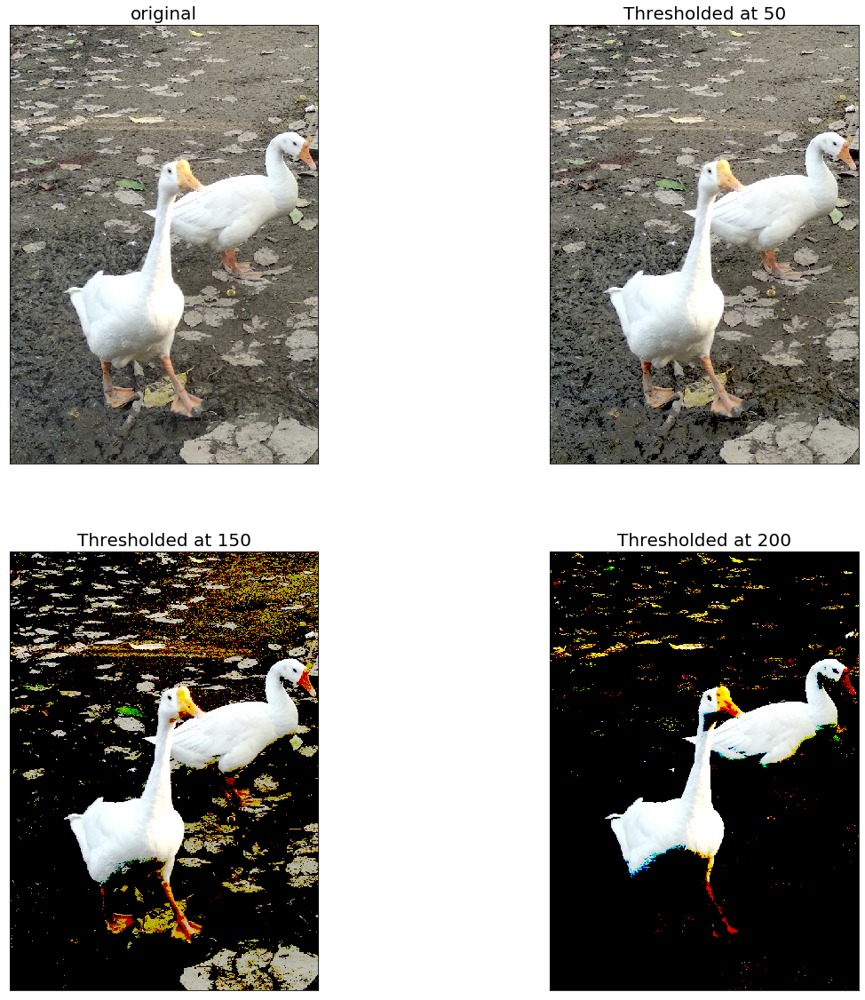

In [20]:
# Thresholding normal image
swan = np.asarray(Image.open("imgs/swans.jpg")).copy()
max_i = [50,150,200]
imgs = []
for t in max_i:
    swan_t = swan.copy()
    swan_t[swan_t[:,:,:]<t] = 0
    imgs.append(swan_t)
plot_grid([swan]+imgs,["original"]+[f"Thresholded at {t}" for t in max_i])

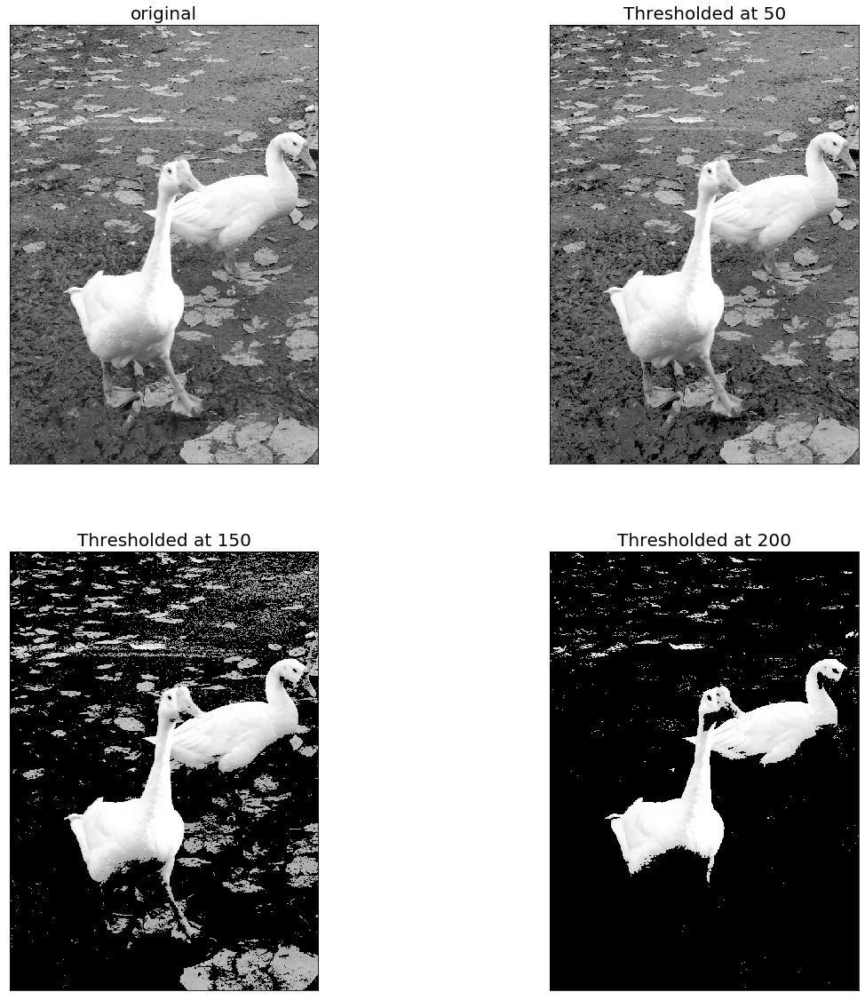

In [21]:
# Thresholding binary image
swan = np.asarray(Image.open("imgs/swans.jpg").convert("L")).copy()
max_i = [50,150,200]
imgs = []
for t in max_i:
    swan_t = swan.copy()
    swan_t[swan_t[:,:]<t] = 0
    imgs.append(swan_t)
plot_grid([swan]+imgs,["original"]+[f"Thresholded at {t}" for t in max_i])

## Changing color space

RGB is one type of color space. Yet, there are many other color spaces that looks at images differently. You may search for them and learn about the possible operations and transformations that can be done in the space. Here we discuss one example of a color space: HSV. 

HSV is closer to how humans perceive color. It has three components: hue, saturation, and value. This color space describes colors (hue or tint) in terms of their shade (saturation or amount of gray) and their brightness value

<img src="imgs/HSV_color_solid_cylinder.png" width=400 />
<img src="imgs/HSV-ColorSpace-OpenCV.png" width=400 />


In [1]:
# needed imports
from skimage import color

ImportError: cannot import name '_validate_lengths'

In [6]:
# Openning parrot image 
# copy to allow modification
parrot = np.asarray(Image.open("imgs/parrot.png")).copy()

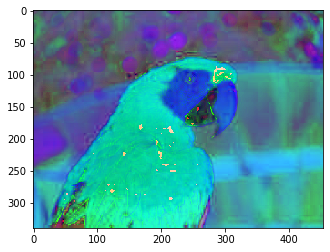

In [24]:
# changing an image to hsv color space
hsv_parrot = color.rgb2hsv(parrot) # from RGB to HSV color space
# because imshow expects r,g,b, the image below doesn't reflect reality
plt.imshow(hsv_parrot)

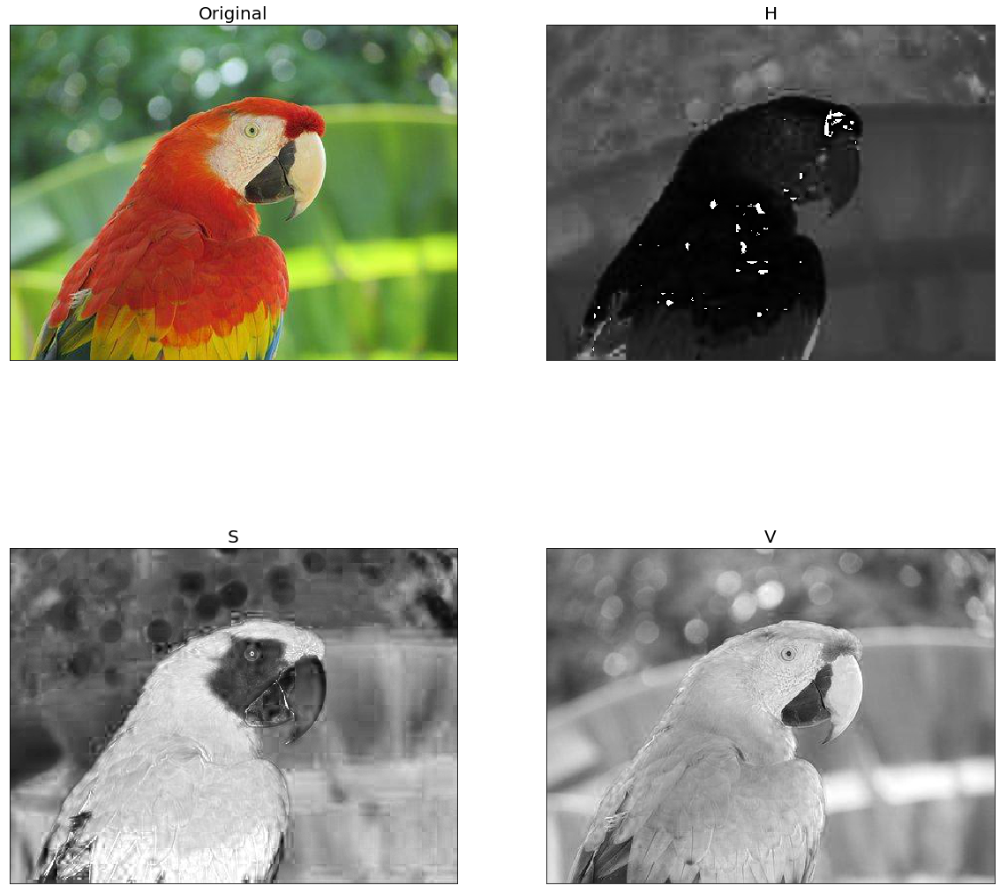

In [27]:
## Plot 3 hsv channels 
plot_grid([parrot,hsv_parrot[:,:,0],hsv_parrot[:,:,1],hsv_parrot[:,:,2]],
          ["Original","H","S","V"])

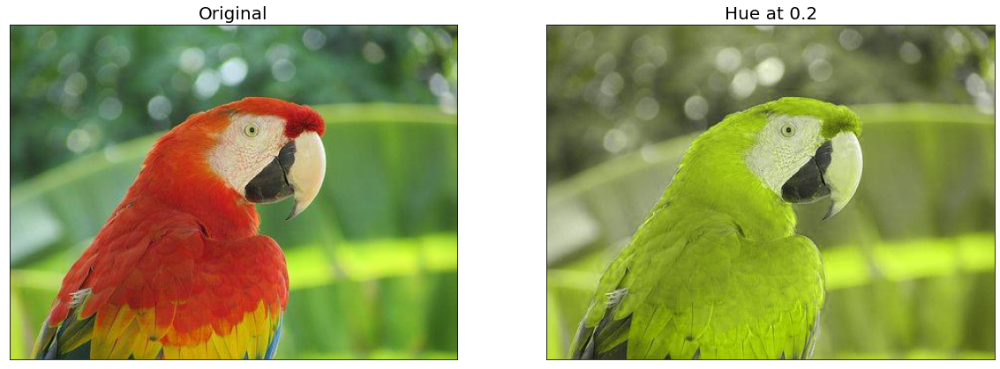

In [14]:
# Apply transformation in hsv color space
import matplotlib

heu = 0.2
hsv_porrot = matplotlib.colors.rgb_to_hsv(parrot)
hsv_porrot[:, :, 0] = heu # change the heu
new_parrot = matplotlib.colors.hsv_to_rgb(hsv_porrot) # from HSV back to RGB
new_parrot = new_parrot.astype(np.uint8)
plot_grid([parrot,new_parrot],["Original",f"Hue at {heu}"])

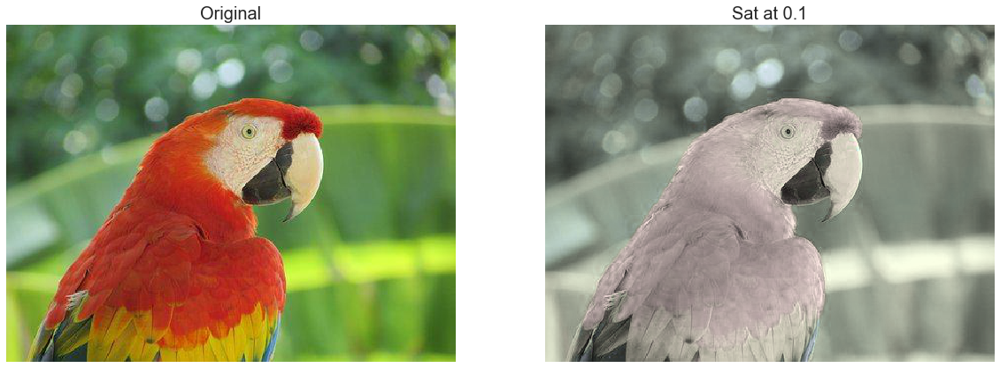

In [301]:
# Apply transformation in hsv color space
sat = 0.1
hsv_porrot = color.rgb2hsv(parrot)
hsv_porrot[:, :, 1] = sat # change the saturation
new_parrot = color.hsv2rgb(hsv_porrot) # from HSV back to RGB
plot_grid([parrot,new_parrot],["Original",f"Sat at {sat}"])

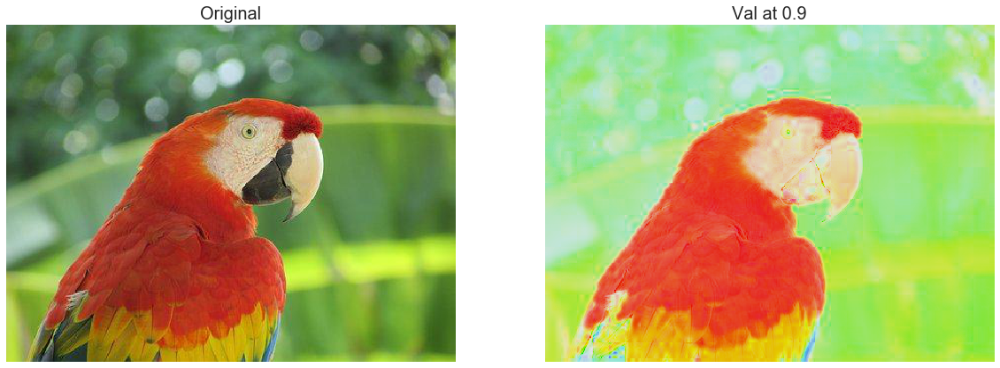

In [304]:
# Apply transformation in hsv color space
val = 0.9
hsv_porrot = color.rgb2hsv(parrot)
hsv_porrot[:, :, 2] = val # change the value
new_parrot = color.hsv2rgb(hsv_porrot) # from HSV back to RGB
plot_grid([parrot,new_parrot],["Original",f"Val at {val}"])

### Color blind test

In [198]:
# Openning Ishihara image 
ishihara = np.asarray(Image.open("imgs/Ishihara.png")).copy()

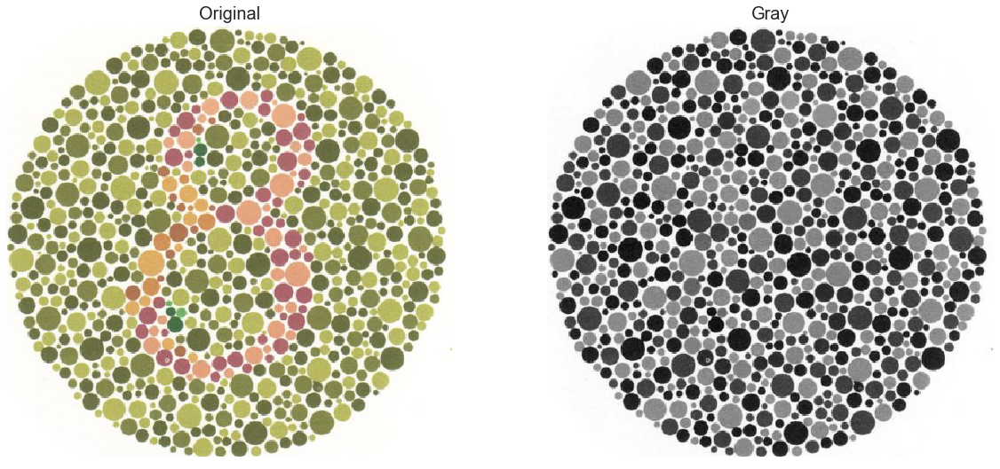

In [199]:
# converting to gray
ishihara_gray = color.rgb2gray(ishihara)
plot_grid([ishihara,ishihara_gray],["Original","Gray"])

## Advance color analysis

You may think of images as a series of random numbers. Whether you group the channels or deal with them seperately, an image can make use of all statistical analysis techniques and distribution transformations. Below we show some example of studying images statistically. 

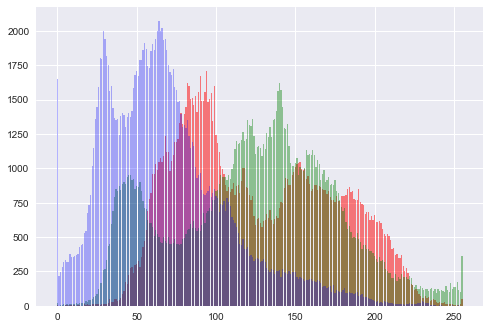

In [200]:
# lets see the histogram of each channel in our parrot image
parrot = Image.open("imgs/parrot.png")
pl = parrot.histogram()
plt.bar(range(256), pl[:256], color='r', alpha=0.5)
plt.bar(range(256), pl[256:2*256], color='g', alpha=0.4)
plt.bar(range(256), pl[2*256:], color='b', alpha=0.3)
plt.show()

The colors clearly shows normal distribution with multiple peaks. First transformation we can apply is to transform them to a perfect normal distribution

In [201]:
#import matplotlib.pylab as pylab
plt.style.use('seaborn')
def normalize_img(s):
    """
    Return image to range [0,256]
    """
    start = 0
    end = 255
    width = end - start
    res = (s - s.min())/(s.max() - s.min()) * width + start
    return res.astype(np.uint8)

def plot_with_histogram(im,title,ax0,ax1):
    ax0.imshow(im)
    a = ax1.hist(im[:,:,0].flatten(),bins=256, range=(0, 256),alpha=0.8,)
    b = ax1.hist(im[:,:,1].flatten(),bins=256, range=(0, 256), alpha=0.8)
    c = ax1.hist(im[:,:,2].flatten(),bins=256, range=(0, 256), alpha=0.8)
    ax0.set_title(title,size=20)
    ax0.grid(False)

**Log transformation**

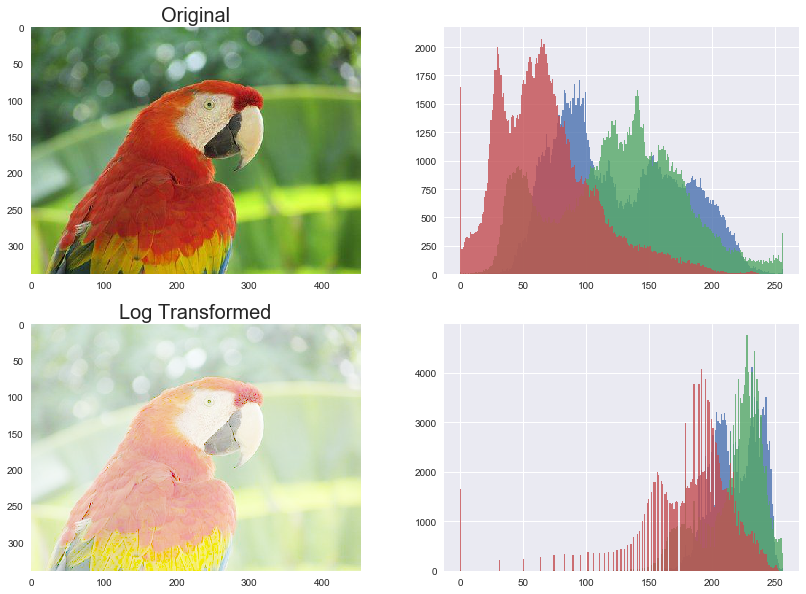

In [202]:
parrot = np.asarray(parrot)

parrot_c = parrot.copy()
parrot_tf = parrot_c.astype(np.float) 
parrot_t = normalize_img(np.log(1+parrot_tf))

fig, ax = plt.subplots(nrows=2,ncols=2,figsize=(14, 10))
plot_with_histogram(parrot,"Original",ax[0,0],ax[0,1])
plot_with_histogram(parrot_t,"Log Transformed",ax[1,0],ax[1,1])

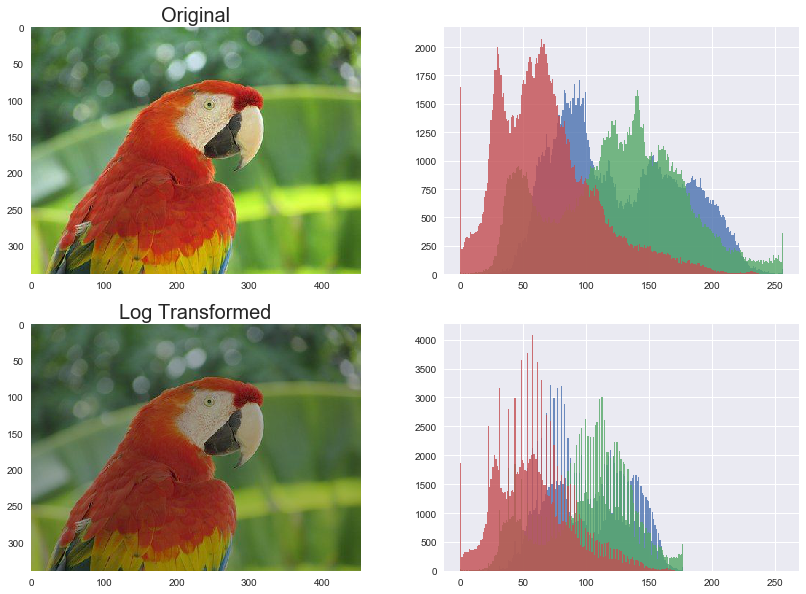

In [203]:
parrot_t = (255*np.log(1+parrot_tf/255)).astype(np.uint8)

fig, ax = plt.subplots(nrows=2,ncols=2,figsize=(14, 10))
plot_with_histogram(parrot,"Original",ax[0,0],ax[0,1])
plot_with_histogram(parrot_t,"Log Transformed",ax[1,0],ax[1,1])

### Power-law transform

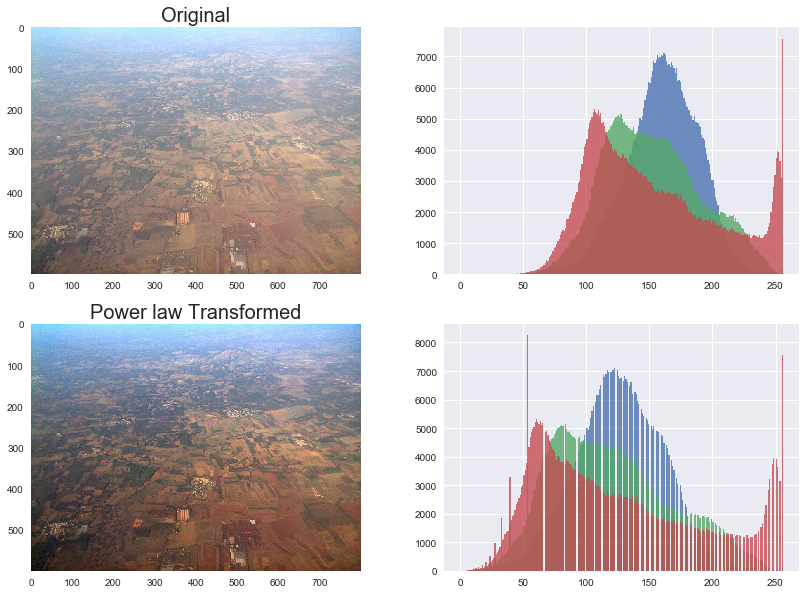

In [204]:
earth = np.asarray(Image.open('imgs/earthfromsky.jpg')).copy()
earth_f = earth.astype(np.float)
gamma = 1.5
earth_t = normalize_img(earth_f**gamma)
fig, ax = plt.subplots(nrows=2,ncols=2,figsize=(14, 10))
plot_with_histogram(earth,"Original",ax[0,0],ax[0,1])
plot_with_histogram(earth_t,"Power law Transformed",ax[1,0],ax[1,1])

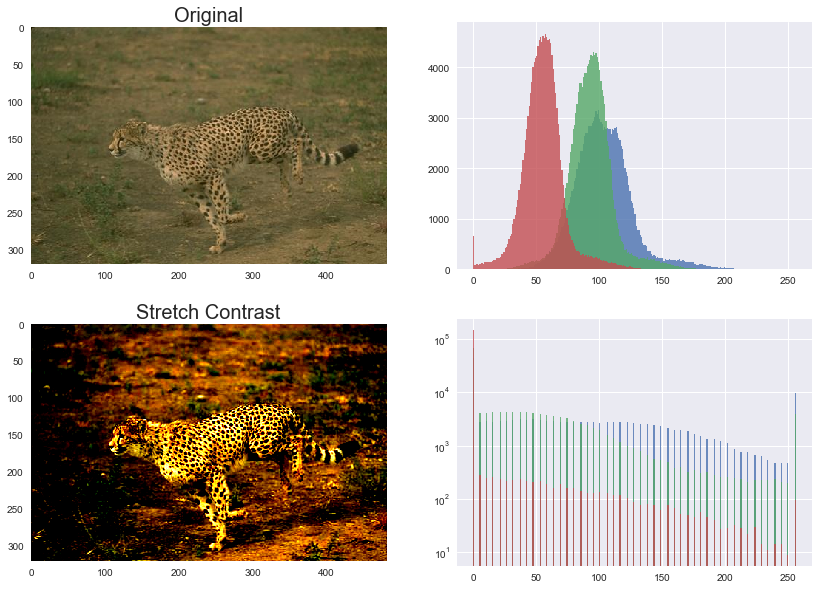

In [205]:
contrast = np.vectorize(lambda c: 0 if c < 70 else (255 if c > 150 else (255*c - 22950) / 48))
cheetah = np.asarray(Image.open('imgs/cheetah.png')).copy()
cheetah_f = cheetah.astype(np.float)
cheetah_t = np.clip(contrast(cheetah),0,255)
fig, ax = plt.subplots(nrows=2,ncols=2,figsize=(14, 10))
plot_with_histogram(cheetah,"Original",ax[0,0],ax[0,1])
plot_with_histogram(cheetah_t,"Stretch Contrast",ax[1,0],ax[1,1])
ax[1,1].set_yscale("log",basey=10)

## Image manipulation

In many cases, images don't come in the shape, size, or oriantation we want. Because our images are 2D arrays, we can basically manipulate it to anything we need. For the purpose of this chapter, we will show how to slice, resize (make small), and rotate

### Slicing

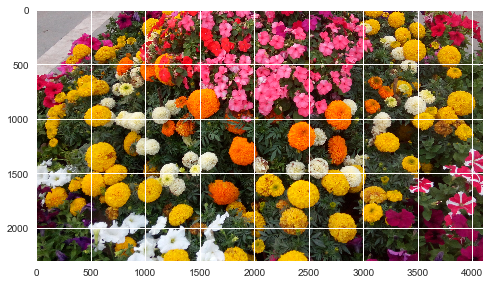

In [206]:
# Openning flowers image 
flowers = np.asarray(Image.open("imgs/flowers.png")).copy()
plt.imshow(flowers)

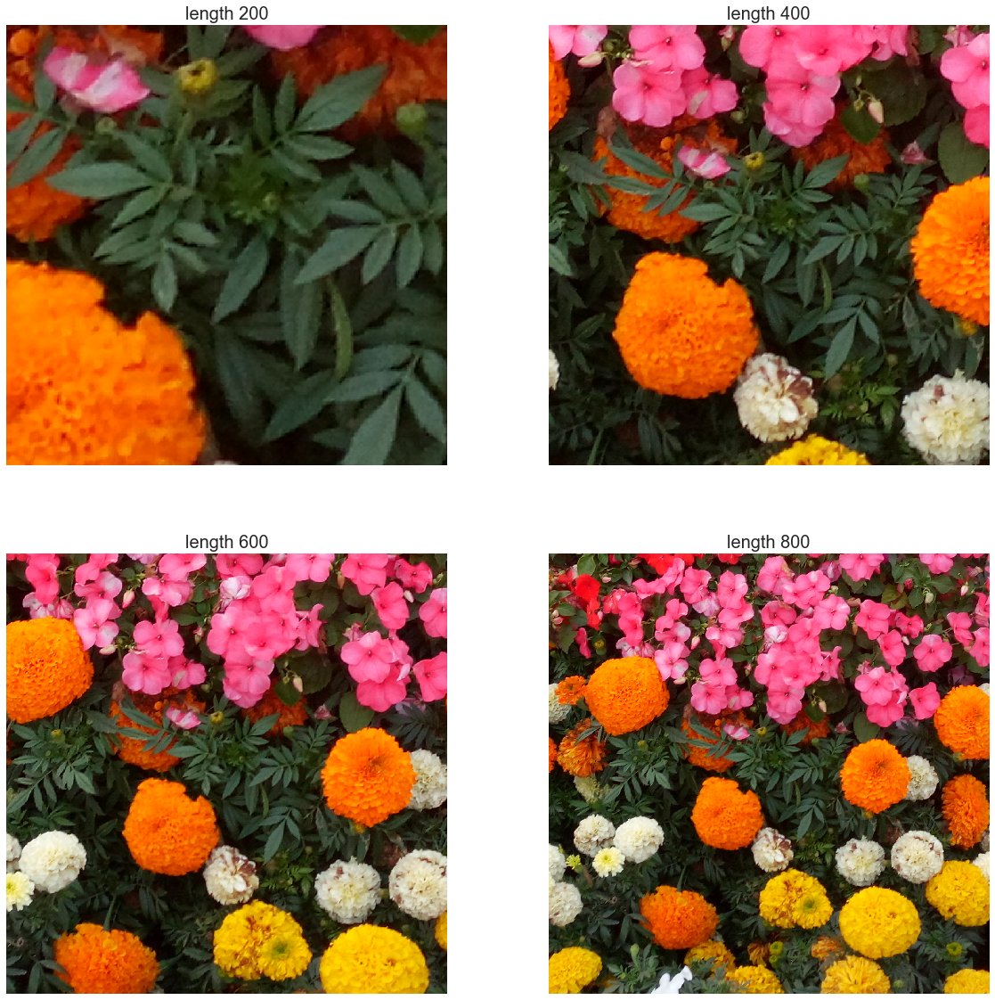

In [207]:
# basic slicing
hside = [200,400,600,800]
height,width,_ = flowers.shape
mx,my = width//2,height//2
imgs = [flowers[my-s:my+s,mx-s:mx+s] for s in hside]
plot_grid(imgs,[f"length {s}" for s in hside])

In [29]:
X,Y = np.ogrid[-10:10,-10:10]

In [32]:
X + Y > 5

array([[False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False],
       [False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False],
       [False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False],
       [False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False],
       [False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False],
       [False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False],
       [Fa

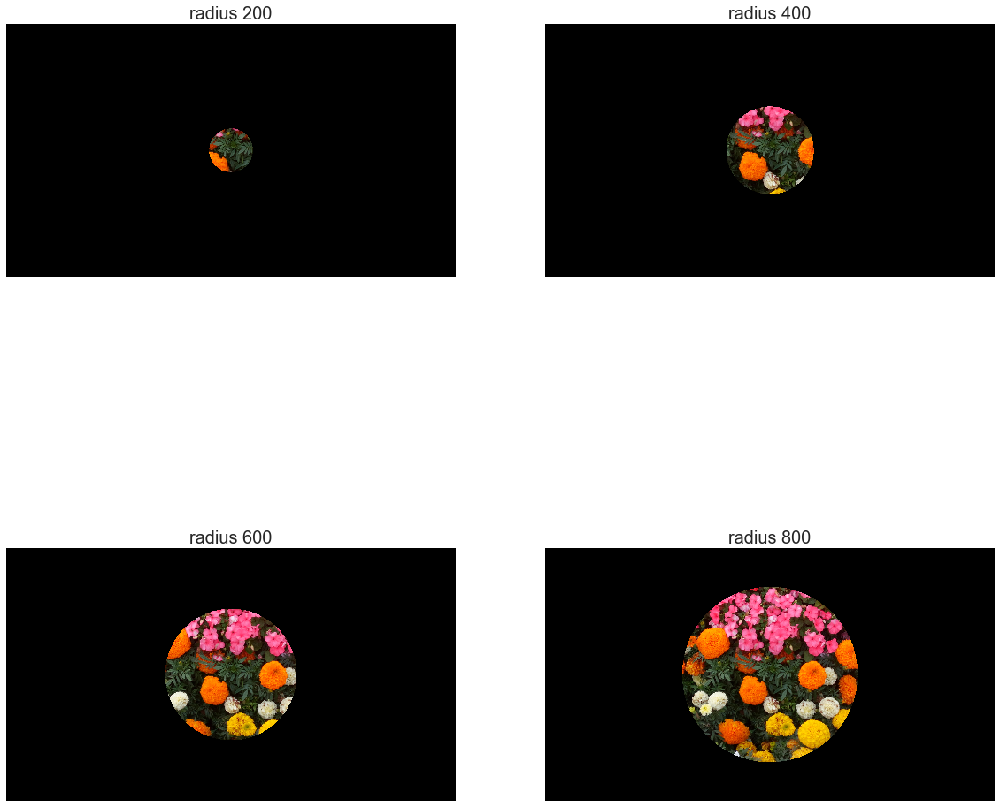

In [244]:
# advance slicing
height, width, _ = flowers.shape
X, Y = np.ogrid[0:height, 0:width]
my,mx = width//2,height//2
radii = [200,400,600,800]
imgs = []
for r in radii:
    outmask = (X - mx) ** 2 + (Y - my) ** 2 > r**2
    flowers_disk = flowers.copy()
    transp = [255,255,255,255]
    black = [0,0,0,255]
    flowers_disk[outmask] = black
    imgs.append(flowers_disk)

plot_grid(imgs,[f"radius {r}" for r in radii])

## Combining Slicing and Transformation

In [34]:
cheetah = np.asarray(Image.open('imgs/cheetah.png'))[:,:,:3]

#get the dimensions of the image
n,m,d = cheetah.shape

#create an open grid for our image
x,y = np.ogrid[0:n, 0:m]

#get the x and y center points of our image
center_x = n/2
center_y = m/2

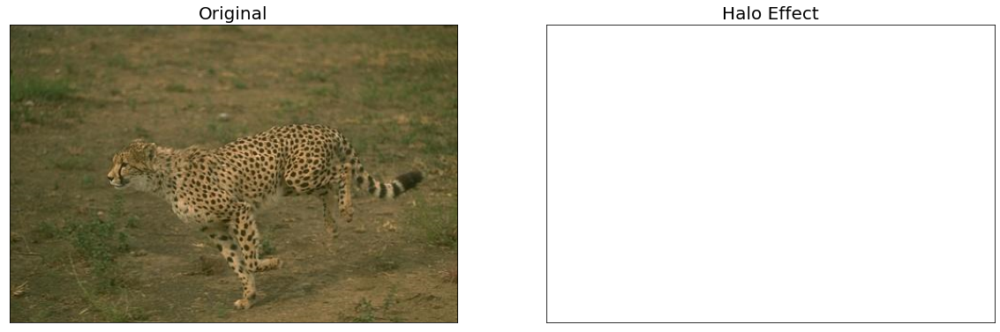

In [40]:
#set the intensity of the halo
intensity = 50.0

#create a noramlizing constant so the halo fully fades out at the corners
denominator = intensity/((n/2)**2 + (m/2)**2)

#get the normalized squared distances of each pixel from the center
squared_distances = intensity*((x-center_x)**2 + (y-center_y)**2)*denominator

#reshape this 2D matrix into a 3D matrix 
squared_distances = squared_distances.reshape(n,m,1)

#"stack" three copies of this 3D matrix to create a numpy array with the same dims as our image
stacked_squared_dists = np.concatenate([squared_distances]*3, axis=2)

#create an edited image by adding our original image to our halo
editedImg = cheetah + stacked_squared_dists

#recast the edited image to integers
editedImg = np.clip(editedImg.astype(int),0,255)

#show image
plot_grid([cheetah,editedImg],["Original","Halo Effect"])

### Resize (make small)

(4061, 2945)


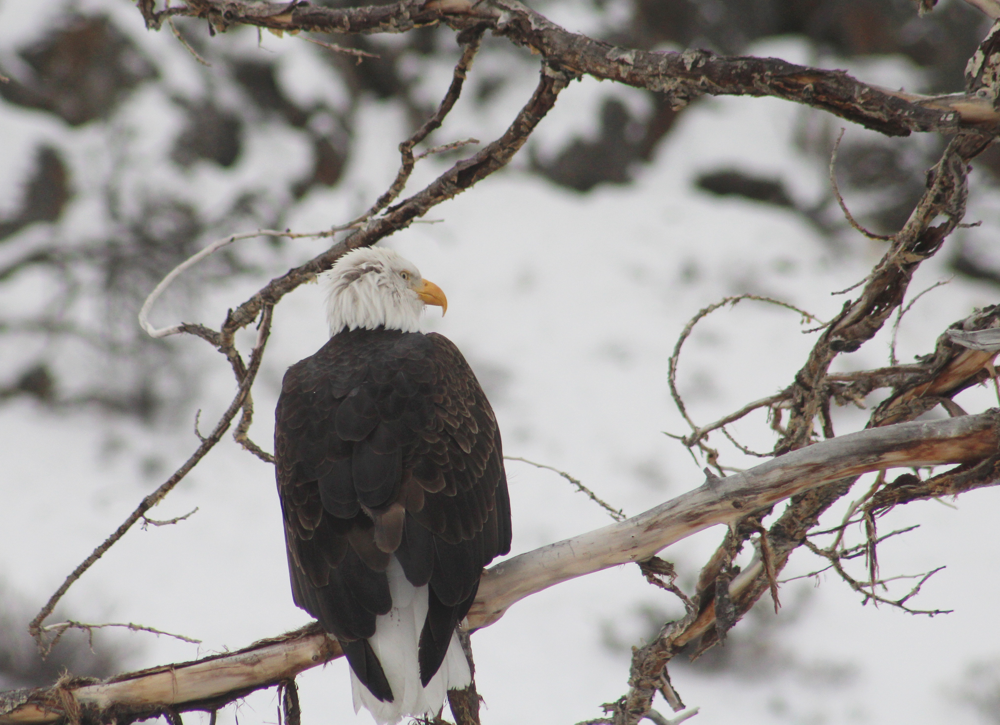

In [211]:
# resizing by using Image class
eagle = Image.open("imgs/eagle.jpg")
print(eagle.size)
eagle

(2030, 1472)


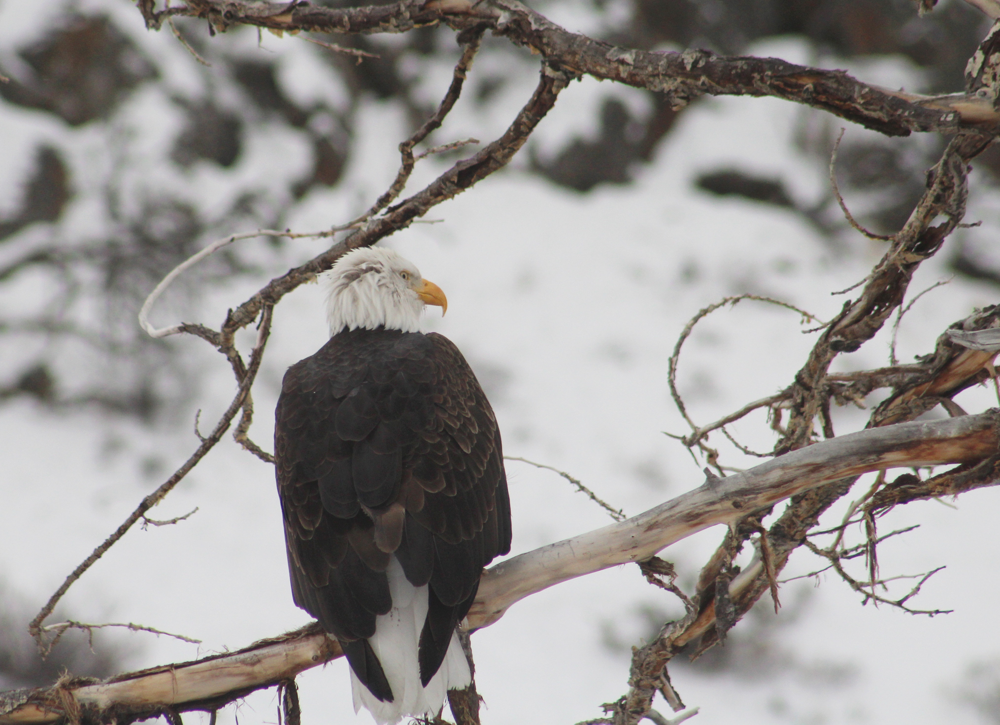

In [212]:
# half the size
eagle_half = eagle.resize((int(eagle.width*0.5),int(eagle.height*0.5)))
print(eagle_half.size)
eagle_half

(406, 294)


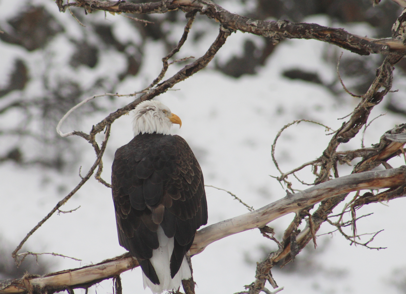

In [213]:
# %10 the size
eagle_half = eagle.resize((int(eagle.width*0.1),int(eagle.height*0.1)))
print(eagle_half.size)
eagle_half

(1473, 2031, 3)


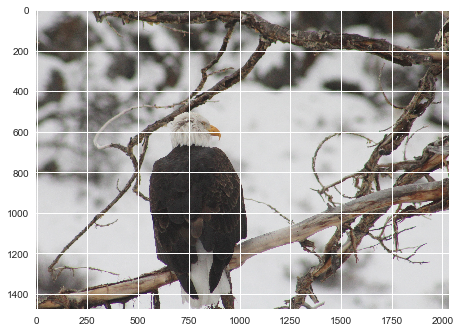

In [311]:
# Resizing by subsampling
subsample = 2
eagle_np = np.asarray(eagle)
eagle_subsampled = eagle_np[::subsample,::subsample]
print(eagle_subsampled.shape)
plt.imshow(eagle_subsampled)

### Affine transformation

In [28]:
# finding cooficients from four points
def find_coeffs(source_coords, target_coords):
    matrix = []
    for s, t in zip(source_coords, target_coords):
        matrix.append([t[0], t[1], 1, 0, 0, 0, -s[0]*t[0], -s[0]*t[1]])
        matrix.append([0, 0, 0, t[0], t[1], 1, -s[1]*t[0], -s[1]*t[1]])
    A = np.matrix(matrix, dtype=np.float)
    B = np.array(source_coords).reshape(8)
    res = np.dot(np.linalg.inv(A.T * A) * A.T, B)
    
    return np.array(res).reshape(8)

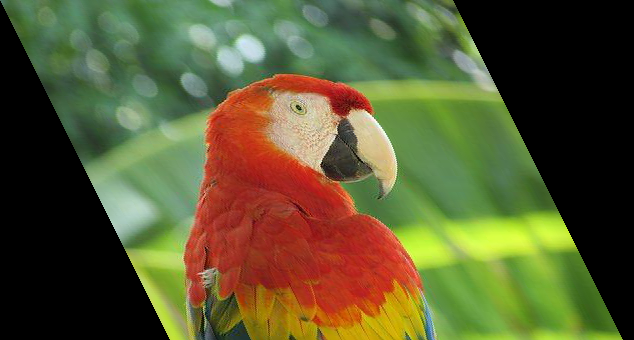

In [15]:
# Sheer
parrot = Image.open("imgs/parrot.png")
parrot.transform((int(1.4*parrot.width), parrot.height), Image.AFFINE,data=(1,-0.5,0,0,1,0))

### Perspective transformation

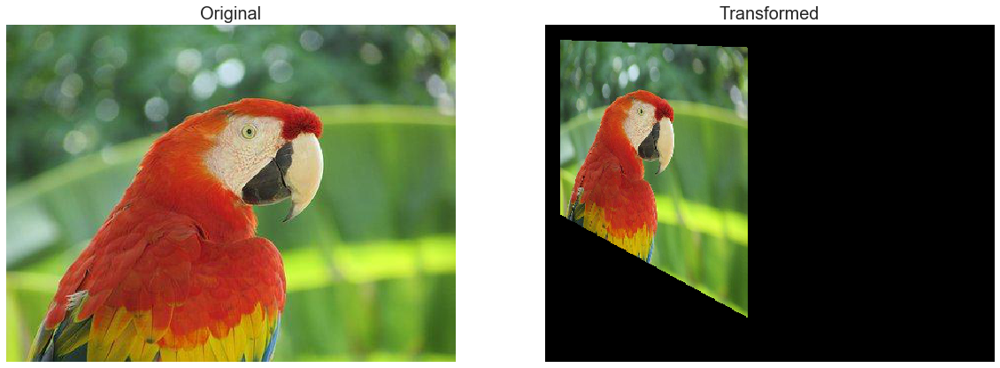

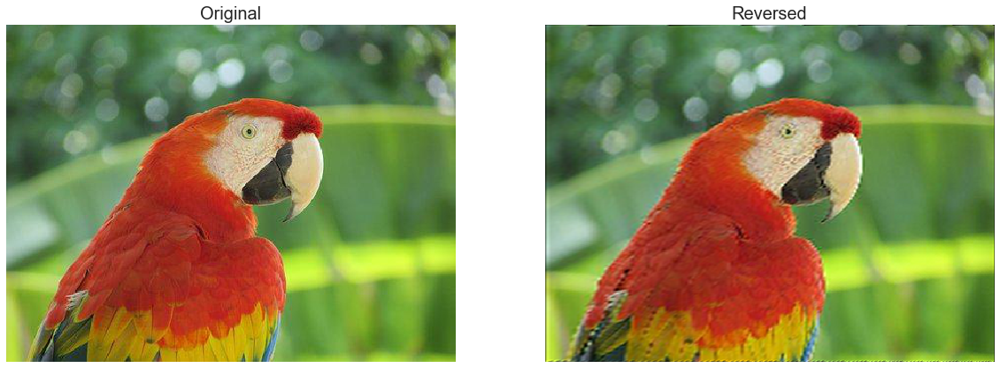

In [217]:
# transformation
h,w = parrot.size
params = find_coeffs(
[(0,0),(w,0),(w,h),(0,h)],
[(15, 15), (140, 20), (140, 340), (15, 250)],
)
parrot_trans = parrot.transform((parrot.width, parrot.height), Image.PERSPECTIVE, params,
Image.BICUBIC)
plot_grid([np.asarray(parrot),np.asarray(parrot_trans)],["Original","Transformed"])

# restoring from transformation
params_back = find_coeffs(
[(15, 15), (140, 20), (140, 340), (15, 250)],
[(0,0),(w,0),(w,h),(0,h)]
)
parrot_back = parrot_trans.transform((parrot.width, parrot.height), Image.PERSPECTIVE, params_back,
Image.BICUBIC)
plot_grid([np.asarray(parrot),np.asarray(parrot_back)],["Original","Reversed"])

In [7]:
# Sheer
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
towmen = np.asarray(Image.open("imgs/2men.jpeg"))

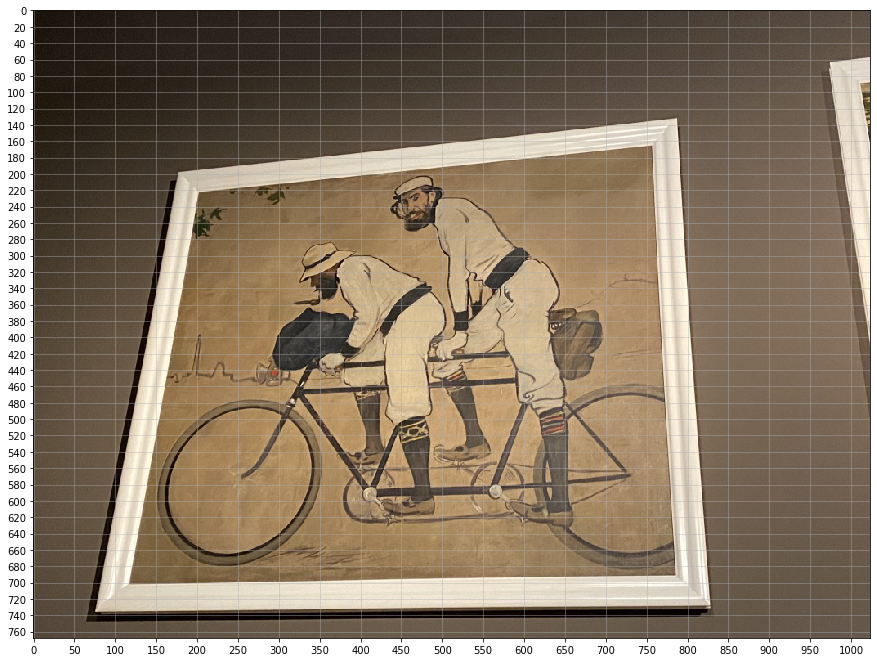

In [23]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)
fig.set_size_inches((15,15))
# Major ticks every 20, minor ticks every 5
major_ticks = np.arange(0, towmen.shape[0], 20)
minor_ticks = np.arange(0, towmen.shape[1], 50)

ax.set_xticks(minor_ticks)
# ax.set_xticks(minor_ticks, minor=True)
ax.set_yticks(major_ticks)
# ax.set_yticks(minor_ticks, minor=True)

# And a corresponding grid
ax.grid(which='both')

# Or if you want different settings for the grids:
ax.grid(which='minor', alpha=0.2)
ax.grid(which='major', alpha=0.5)
ax.imshow(towmen)
plt.show()

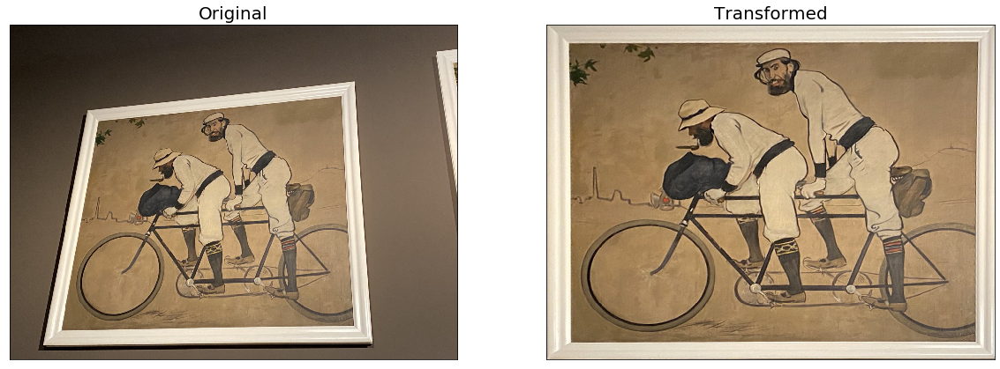

In [4]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
# finding cooficients from four points
def find_coeffs(source_coords, target_coords):
    matrix = []
    for s, t in zip(source_coords, target_coords):
        matrix.append([t[0], t[1], 1, 0, 0, 0, -s[0]*t[0], -s[0]*t[1]])
        matrix.append([0, 0, 0, t[0], t[1], 1, -s[1]*t[0], -s[1]*t[1]])
    A = np.matrix(matrix, dtype=np.float)
    B = np.array(source_coords).reshape(8)
    res = np.dot(np.linalg.inv(A.T * A) * A.T, B)
    return np.array(res).reshape(8)
# loading image
twomen = Image.open("imgs/2men.jpeg")
#width,height
w,h = twomen.size
#origial image points
p1 = [(180,200),(780,138),(75,736),(825,730)]
#transformed image points
p2 = [(0,0),(w,0),(0,h),(w,h)]
#finding transformation paramenters
params = find_coeffs(p1,p2)
# transforming
twomen_trans = twomen.transform((w, h), Image.PERSPECTIVE, params,Image.BICUBIC)
#plotting
plot_grid([np.asarray(twomen),np.asarray(twomen_trans)],["Original","Transformed"])

In [58]:
towmen_trans.save("imgs/2men_fixed.jpeg")

## Two images operations

### $\alpha$-blending 

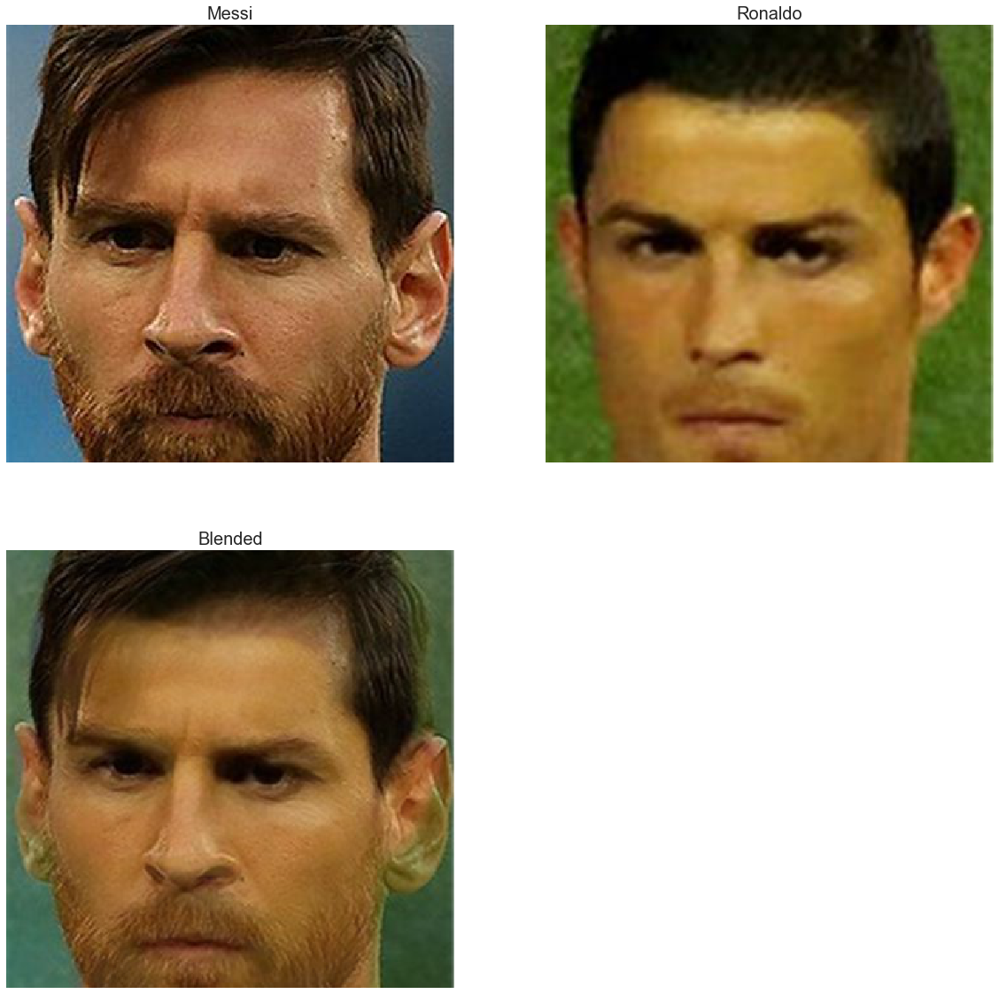

In [218]:
# blending using Image class
messi = Image.open("imgs/messi.jpg")
ronaldo = Image.open("imgs/ronaldo.jpg")
blended = Image.blend(messi, ronaldo, alpha=0.5)
plot_grid([np.asarray(a) for a in [messi,ronaldo,blended]],
          ["Messi","Ronaldo","Blended"])

**Implement blending for numpy array**

In [313]:
def blend(im1,im2,alpha):
    # convert to float
    im1f,im2f = im1.astype(float),im2.astype(float)
    # getting each image portion
    im1p = (1-alpha)*im1f
    im2p = alpha*im2f
    # restore image to uint8
    im1int8,im2int8 = im1p.astype(np.uint8),im2p.astype(np.uint8)
    # clip in case of overflow
    return np.clip(im1int8 + im2int8, 0, 255) 

In [314]:
%%capture
# with animation
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

messi = np.asarray(Image.open("imgs/messi.jpg"))
ronaldo = np.asarray(Image.open("imgs/ronaldo.jpg"))

fig, ax = plt.subplots()
xdata, ydata = [], []

def init():
    ax.imshow(ronaldo)
    return []

def update(frame):
    alpha = frame/20
    ax.clear()
    ax.imshow(blend(ronaldo,messi,alpha))
    return []

ani = FuncAnimation(fig, update, frames=np.linspace(1,20),
                     init_func=init, blit=True)

In [315]:
HTML(ani.to_html5_video())

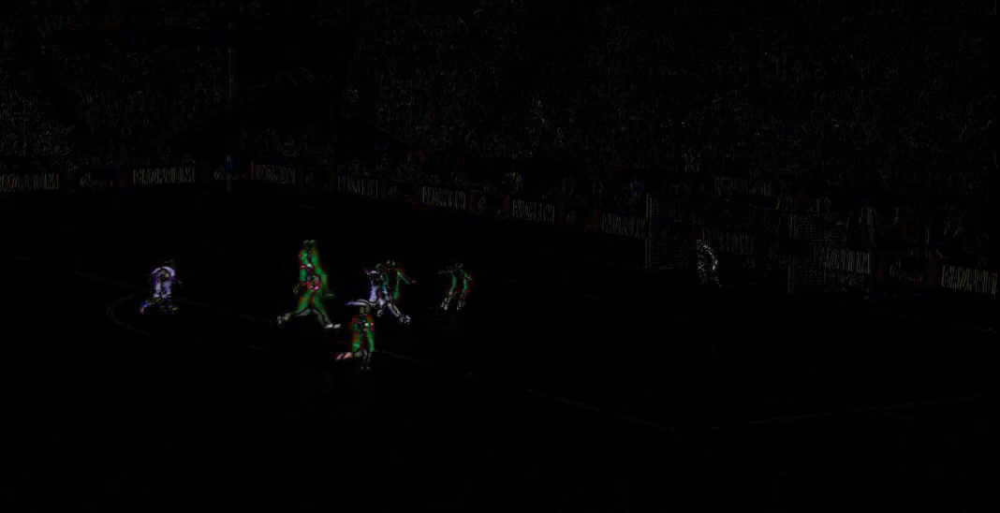

In [222]:
#using ImageChops
from PIL.ImageChops import difference
# load two consecutive frame images from the video
im1 = Image.open("imgs/goal1.png") 
im2 = Image.open("imgs/goal2.png")
im = difference(im1, im2)
im

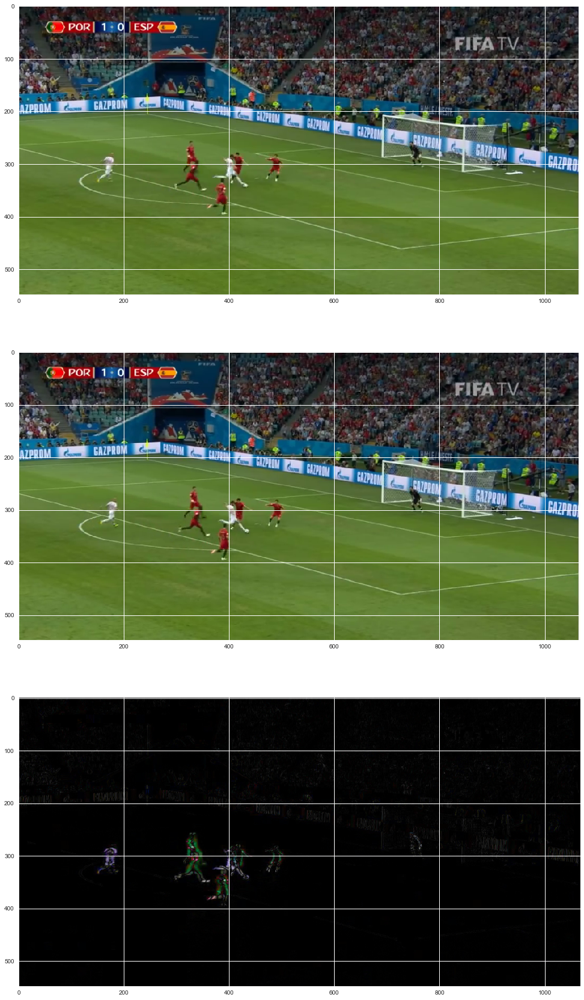

In [223]:
# Using numpy
#using ImageChops
from PIL.ImageChops import difference
# load two consecutive frame images from the video
im1 = np.asarray(Image.open("imgs/goal1.png"))
im2 = np.asarray(Image.open("imgs/goal2.png"))
im = np.clip(np.abs(im1.astype(int)-im2.astype(int)),0,255)
fig,ax = plt.subplots(nrows=3)
ax[0].imshow(im1)
ax[1].imshow(im2)
ax[2].imshow(im)
fig.set_size_inches((20,30))
#plot_grid([im1,im2,im],["Frame 1","Frame 2","Diff"])

## Color Based Classifier

In [224]:
import glob
def plot_dataset(dataset,nrows,ncols,figsize=(5,5)):
    """
    Receive a dataset and plot random subset of it in grid(nrows,ncols)
    """
    np.random.seed(1)
    j = 1
    fig = plt.figure(figsize=(figsize)) 
    fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 
    for i in np.random.choice(len(dataset), nrows*ncols):
        plt.subplot(nrows,ncols,j)
        plt.imshow(dataset[i])
        plt.axis('off')
        j += 1
    plt.show()

def paths_to_numpy(paths,):
    """
    Read list of file paths into numpy array
    """
    images = []
    for f in paths:
        img = Image.open(f)
        images.append(np.asarray(img).copy())
        img.close()
    return images


def load_dataset(path):
    """
    Load scikit-learn based image dataset given path, mode and target_size
    @mode: vector, gray, or color
    return data, and targets (integer values as read from images file names)
    """
    files = glob.glob(f"{path}/*.png")
    data = paths_to_numpy(files)
    return data

In [225]:
# loading players dataset
dataset = load_dataset("dataset/smallbarcavslivercl/")

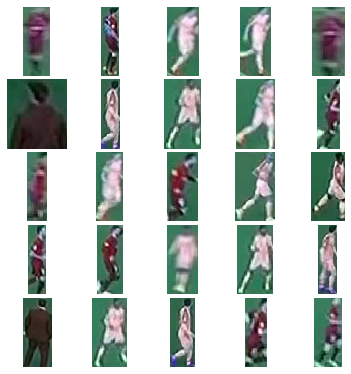

In [226]:
# showing subset of the dataset
plot_dataset(dataset,5,5)

In [227]:
# taking average color per image
avgs = np.array([im.mean(axis=(0,1)) for im in dataset])

Text(100, 160, 'Referee')

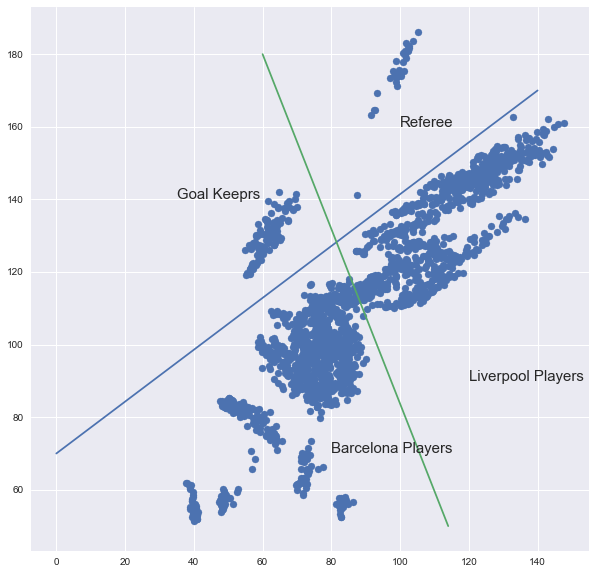

In [228]:
# plotting red vs green
fig, ax = plt.subplots(nrows=1,figsize=(10,10))
ax.scatter(avgs[:,0],avgs[:,1])
bminx, bmax,bminy,bmaxy = 50,90,65,118
lminx,lmaxx,lminy,lmaxy = 100,140,118,160
plt.plot([0,140],[70,170])
plt.plot([114,60],[50,180])
plt.text(120,90,"Liverpool Players",fontsize=15)
plt.text(80,70,"Barcelona Players",fontsize=15)
plt.text(35,140,"Goal Keeprs",fontsize=15)
plt.text(100,160,"Referee",fontsize=15)

In [229]:
import math
def rotate_via_numpy(xy, radians):
    """Use numpy to build a rotation matrix and take the dot product."""
    x, y = xy
    c, s = np.cos(radians), np.sin(radians)
    j = np.matrix([[c, s], [-s, c]])
    m = np.dot(j, [x, y])

    return float(m.T[0]), float(m.T[1])

def rotate_origin_only(xy, radians):
    """Only rotate a point around the origin (0, 0)."""
    x, y = xy
    xx = x * math.cos(radians) + y * math.sin(radians)
    yy = -x * math.sin(radians) + y * math.cos(radians)

    return xx, yy

In [230]:
norig = np.array([85,125])
xys = [(avg[0],avg[1]) for avg in avgs]
rotatedxy = np.array([rotate_origin_only(xy-norig,np.arctan(100/140)) for xy in xys])

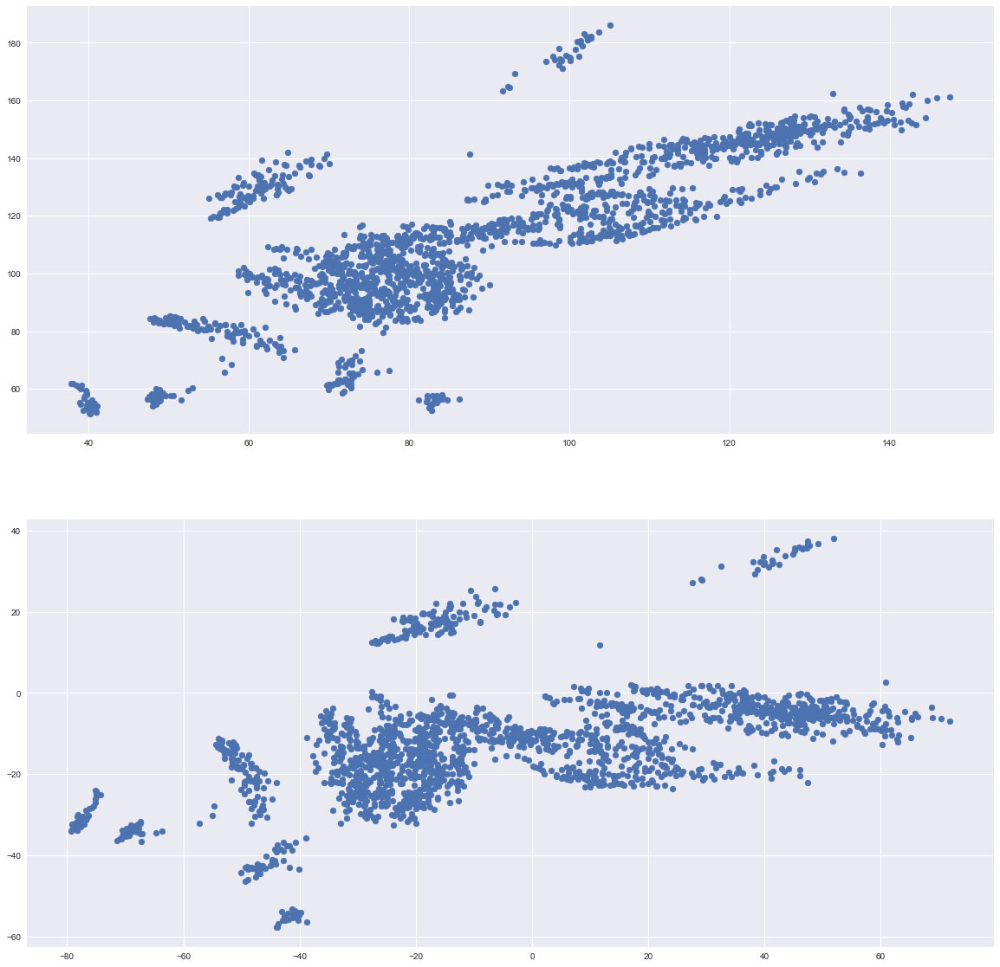

In [231]:
fig, ax = plt.subplots(nrows=2,ncols=1,figsize=(20,20))
ax[1].scatter(rotatedxy[:,0],rotatedxy[:,1])
ax[0].scatter(avgs[:,0],avgs[:,1])
bminx, bmax,bminy,bmaxy = 50,90,65,118
lminx,lmaxx,lminy,lmaxy = 100,140,118,160

In [316]:
newcoord = lambda xy: rotate_origin_only(xy-norig,np.arctan(100/140))
def classify(xy):
    nxy = newcoord(xy)
    x,y = nxy
    if x >= 0 and y >= 0:
        return "Goal Keeper"
    elif x<0 and y >0:
        return "Referee"
    elif x<0 and y < 0:
        return "Barcelona"
    else:
        return "Liverpool"
    

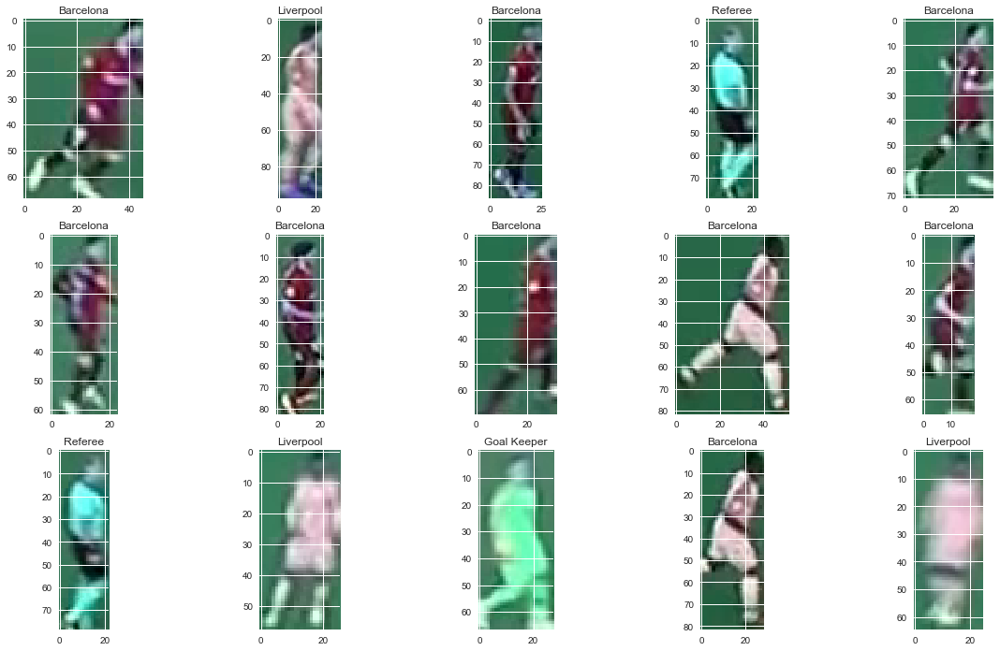

In [317]:
index = np.random.randint(0,len(dataset),15)
ncols = 5
nrows = index.size//ncols
fig, ax = plt.subplots(nrows=nrows,ncols=ncols,figsize=(ncols*4,nrows*4))
for i,ind in enumerate(index):
    img = dataset[ind]
    xy = avgs[ind][0],avgs[ind][1]
    ax[i//5,i%5].imshow(img)
    ax[i//5,i%5].set_title(classify(xy))